In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import loompy
import anndata

sc.settings.verbosity = 3     
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
adata = sc.read_loom('good.loom', X_name='spliced', obs_names='cellID', var_names='GeneName', dtype='float32',validate=False)
adata.obs_names_make_unique() 
adata

/home/yike/.conda/envs/scanpy/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


scanpy==1.9.1 anndata==0.7.5 umap==0.4.6 numpy==1.21.2 scipy==1.5.3 pandas==1.5.2 scikit-learn==0.23.2 statsmodels==0.12.1 python-igraph==0.9.9 louvain==0.7.0 leidenalg==0.8.1


AnnData object with n_obs × n_vars = 13743 × 18072
    obs: 'DC', 'Gender', 'Mousename', 'Plate', 'SortType', 'Time [days]', 'Timepoint', 'TimepointHO', 'Treatment', 'Well', '_index', 'cellRoughSubtype', 'cellSubtype', 'cellSubtypeOld', 'cellType', 'coverage', 'doublet', 'embed_endo_1', 'embed_endo_2', 'fastq', 'number_of_genes_1plusreads'
    var: 'Chromosome', 'Gene stable ID', 'Strand', '_index', 'missing_info', 'n_geneIds'

In [5]:
adata_celltypes={}

celltypes=['Pericyte','Car4+ capillaries','Early Car4- capillaries','Nonproliferative embryonic EC','Late Car4- capillaries']

for celltype in celltypes:
    adata_celltypes[celltype]=adata[adata.obs['cellSubtype']==celltype]

adata_celltypes.keys()

dict_keys(['Pericyte', 'Car4+ capillaries', 'Early Car4- capillaries', 'Nonproliferative embryonic EC', 'Late Car4- capillaries'])

In [6]:
timepoints=['E18.5','P1','P7','P21','P7_HO']

adata_d={}
for timepoint in timepoints:

    key=('Pericyte',timepoint)
    adata_d[key]=adata_celltypes['Pericyte'][adata_celltypes['Pericyte'].obs['TimepointHO']==timepoint]
    
    if timepoint=='E18.5':
        key=('Car4+ capillaries',timepoint)
        adata_d[key]=adata_celltypes['Nonproliferative embryonic EC'][adata_celltypes['Nonproliferative embryonic EC'].obs['TimepointHO']==timepoint]
        #continue #to do
    else:
        key=('Car4+ capillaries',timepoint)
        adata_d[key]=adata_celltypes['Car4+ capillaries'][adata_celltypes['Car4+ capillaries'].obs['TimepointHO']==timepoint]
  
    if timepoint=='E18.5':
        key=('Car4- capillaries',timepoint)
        adata_d[key]=adata_celltypes['Nonproliferative embryonic EC'][adata_celltypes['Nonproliferative embryonic EC'].obs['TimepointHO']==timepoint]
        #continue #to do
    elif timepoint=='P21':
        key=('Car4- capillaries',timepoint)
        adata_d[key]=adata_celltypes['Late Car4- capillaries'][adata_celltypes['Late Car4- capillaries'].obs['TimepointHO']==timepoint]
    else:
        key=('Car4- capillaries',timepoint)
        adata_d[key]=adata_celltypes['Early Car4- capillaries'][adata_celltypes['Early Car4- capillaries'].obs['TimepointHO']==timepoint]

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_ca

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_ca

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_ca

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-27-745b74f99318>:89: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

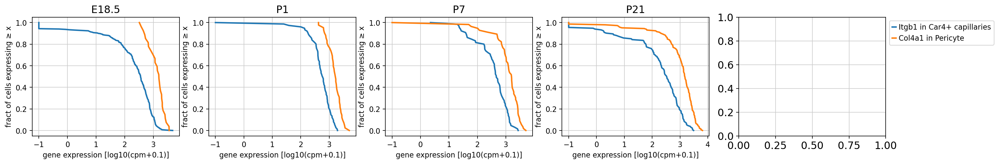

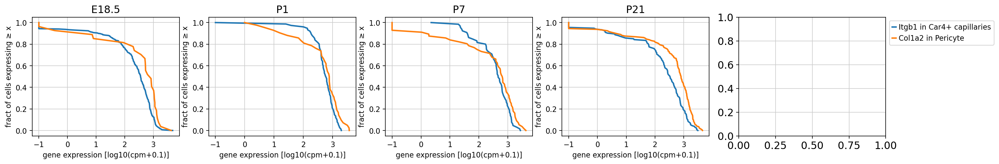

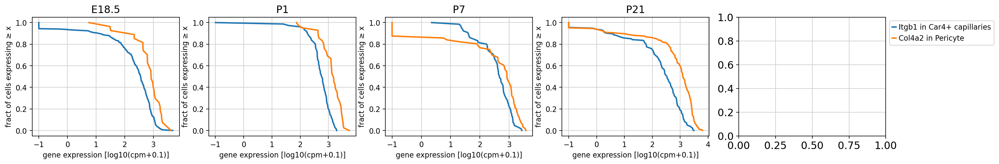

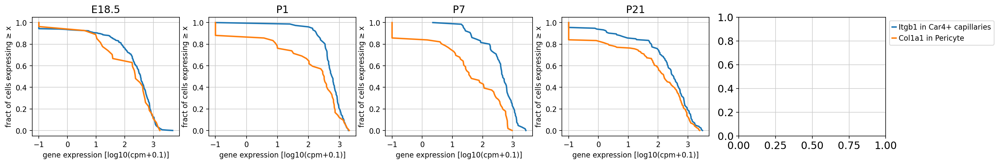

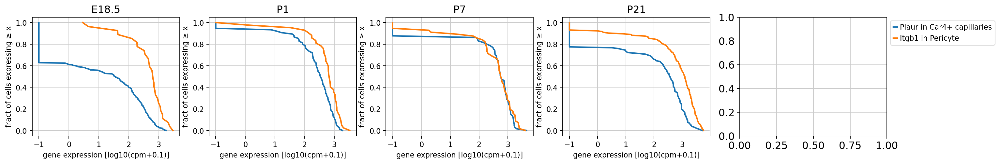

...

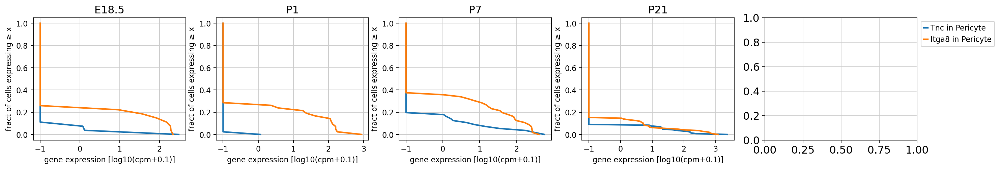

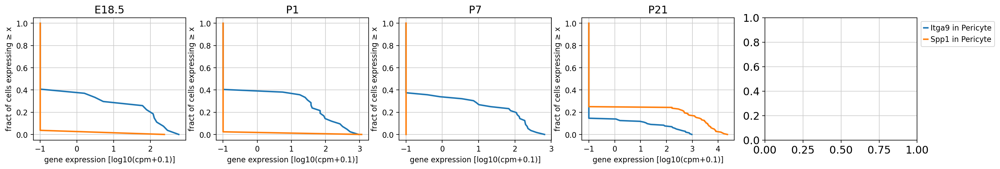

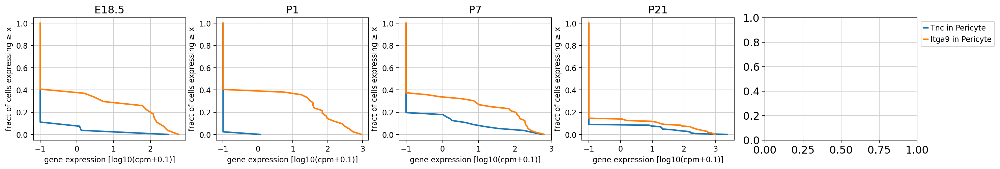

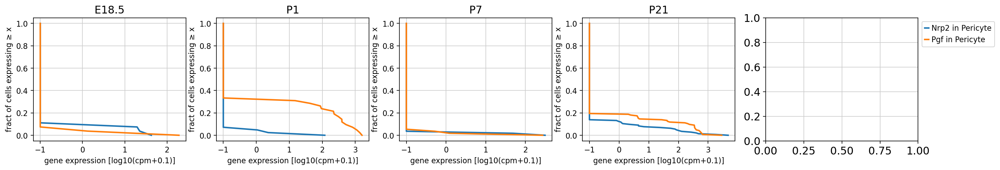

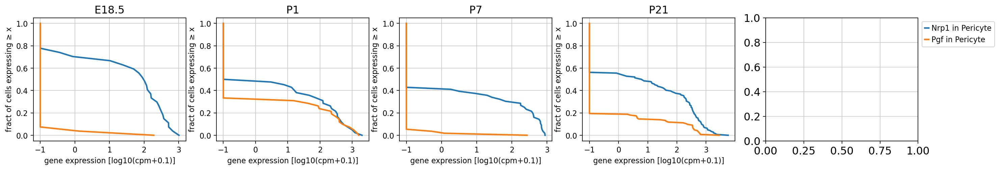

In [27]:
pairs_Car4=[['Itgb1','Col4a1'],['Itgb1','Col1a2'],['Itgb1','Col4a2'],['Itgb1','Col1a1'],
            ['Plaur','Itgb1'],['Plaur','Itga4'],['Plaur','Itgav'],
            ['Fbn1','Itgb1'],['Fbn1','Itga5'],
            ['Nectin3','Cadm1'],
            ['Itgb1','Lamc1'],
            ['Itgb1','Cspg4'],
            ['Pdgfb','Pdgfrb'],
            ['Sirpa','Cd47'],
            ['Sema7a','Itgb1']
           ]
pairs_Early_Car4=[['Col15a1','Itga1'],['Col15a1','Itgb1'],['Col18a1','Itga1'],['Col18a1','Itgb1'],
                  ['Dll1','Notch1'],['Dll1','Notch2'],['Dll1','Notch3'],['Dll1','Notch4'],
                  ['Cxcl12','Cxcr4'],
                  ['Bmp6','Bmpr2'],['Bmp6','Acvr2a'],['Bmp6','Bmpr1a'],['Bmp6','Acvr1'],['Bmp6','Acvr2b'],
                  ['Fzd6','Wnt5a'],['Fzd6','Wnt4'],['Fzd3','Wnt5a'],
                  ['Gas6','Axl'],['Il15ra','Axl'],['Il15ra','Il15'],
                  ['Clcf1','Il6st'],['Clcf1','Lifr']
                 ]
pairs_pericyte=[['Cadm1','Cadm1'],
                ['Cd44','Hbegf'],['Cd44','Hgf'],['Cd44','Spp1'],
                ['Wnt5a','Fzd1'],['Wnt4','Fzd1'],
                ['Bmpr1a','Bmp2'],['Bmpr1a','Bmp4'],['Bmpr1a','Bmp5'],
                ['Wnt5a','Ror1'],['Wnt4','Smo'],['Bmp2','Smo'],
                ['Fn1','Itga8'],['Tnc','Itga8'],
                ['Itga9','Spp1'],['Tnc','Itga9'],
                ['Nrp2','Pgf'],['Nrp1','Pgf']
               ]

pairs_cts=[['Car4+ capillaries','Pericyte'],['Early Car4- capillaries','Pericyte'],['Pericyte','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

for ct1,ct2 in pairs_cts:
    pairs=pairs_dic[ct1]
    for gene1,gene2 in pairs:
        fig,ax=plt.subplots(1,5,figsize=(18,3))
        for i in [0,1,2,3,4]:
            gene1_ct1=adata_dic[ct1][i][:,gene1].X.toarray()[:,0]
            gene1_ct1=np.log10(0.1+gene1_ct1)
            x=np.sort(gene1_ct1)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene1+ ' in ' +ct1,lw=2)
                
            gene2_ct2=(adata_dic[ct2])[i][:,gene2].X.toarray()[:,0]
            gene2_ct2=np.log10(0.1+gene2_ct2)
            x=np.sort(gene2_ct2)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene2+ ' in ' +ct2,lw=2)
                        
            ax[i].set_xlabel('gene expression [log10(cpm+0.1)]',fontsize=10)
            ax[i].tick_params(labelsize=10)
            ax[i].set_ylabel('fract of cells expressing ≥ x',fontsize=10)
            ax[0].legend(loc='upper left',bbox_to_anchor=(5.8,1),bbox_transform=ax[0].transAxes,fontsize=10)
            
            if i==0:
                ax[i].set_title('E18.5')
            elif i==1:
                ax[i].set_title('P1')
            elif i==2:
                ax[i].set_title('P7')
            elif i==3:
                ax[i].set_title('P21')
            else:
                ax[i].set_title('P7_HO')
            
            #ax.grid(False)
            plt.tight_layout()
            plt.subplots_adjust(left=0.05)
            #fig.savefig('figures/interaction_endo_peri/cul/timepoint/'+gene1+' in '+ct1+' & '+gene2+' in '+ct2+'_cumul.png',bbox_inches = 'tight')

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-59-8b589539010c>:90: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_cat

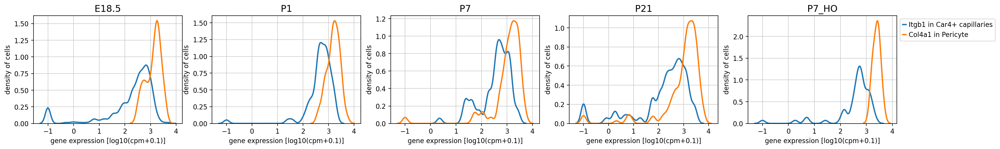

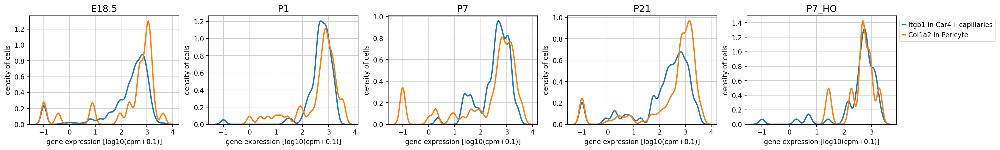

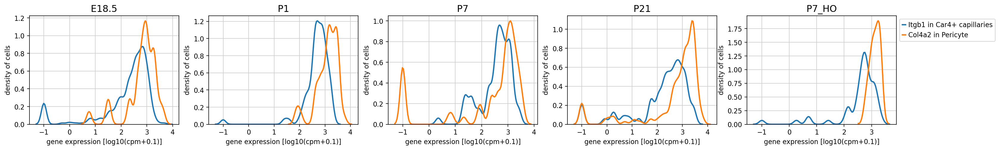

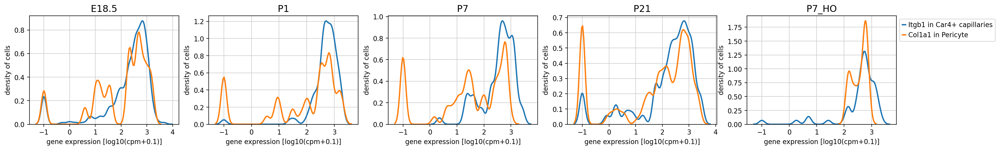

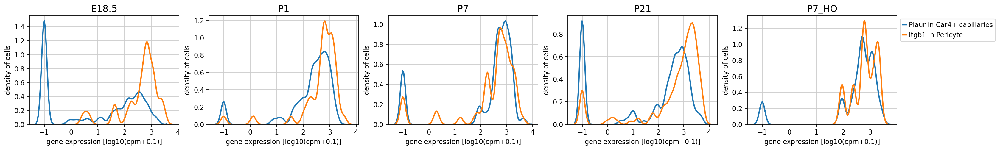

...

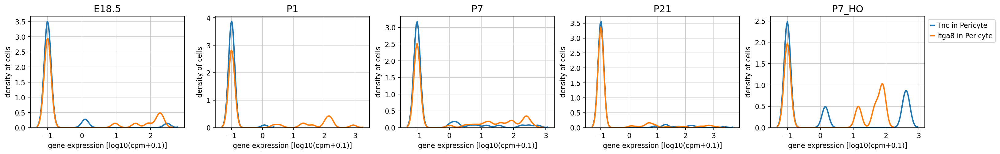

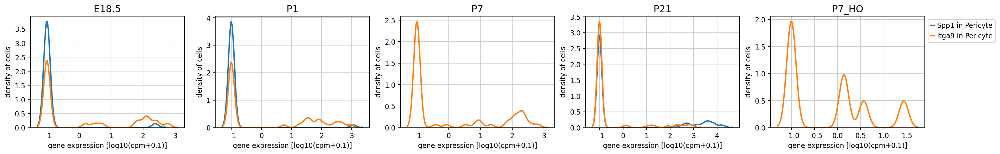

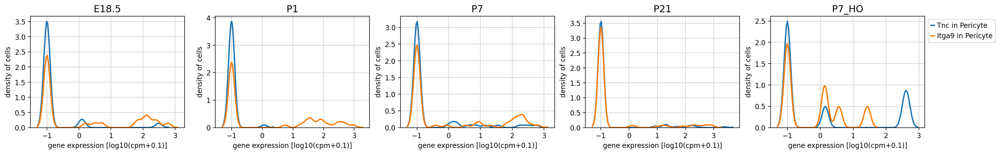

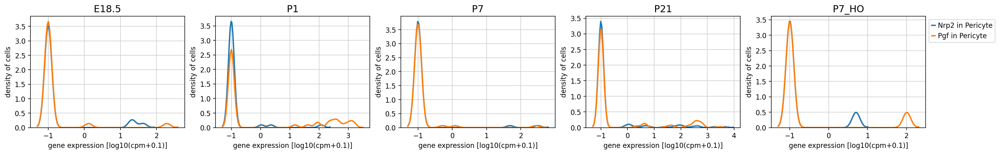

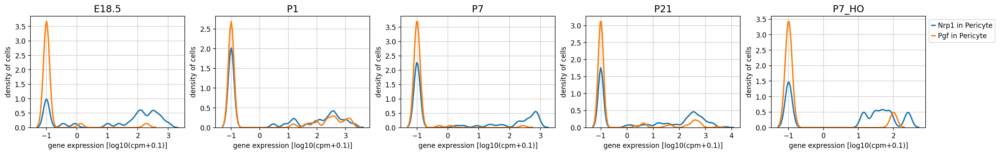

In [59]:
pairs_Car4=[['Itgb1','Col4a1'],['Itgb1','Col1a2'],['Itgb1','Col4a2'],['Itgb1','Col1a1'],
            ['Plaur','Itgb1'],['Plaur','Itga4'],['Plaur','Itgav'],
            ['Fbn1','Itgb1'],['Fbn1','Itga5'],
            ['Nectin3','Cadm1'],
            ['Itgb1','Lamc1'],
            ['Itgb1','Cspg4'],
            ['Pdgfb','Pdgfrb'],
            ['Sirpa','Cd47'],
            ['Sema7a','Itgb1']
           ]
pairs_Early_Car4=[['Col15a1','Itga1'],['Col15a1','Itgb1'],['Col18a1','Itga1'],['Col18a1','Itgb1'],
                  ['Dll1','Notch1'],['Dll1','Notch2'],['Dll1','Notch3'],['Dll1','Notch4'],
                  ['Cxcl12','Cxcr4'],
                  ['Bmp6','Bmpr2'],['Bmp6','Acvr2a'],['Bmp6','Bmpr1a'],['Bmp6','Acvr1'],['Bmp6','Acvr2b'],
                  ['Fzd6','Wnt5a'],['Fzd6','Wnt4'],['Fzd3','Wnt5a'],
                  ['Gas6','Axl'],['Il15ra','Axl'],['Il15ra','Il15'],
                  ['Clcf1','Il6st'],['Clcf1','Lifr']
                 ]
pairs_pericyte=[['Cadm1','Cadm1'],
                ['Cd44','Hbegf'],['Cd44','Hgf'],['Cd44','Spp1'],
                ['Wnt5a','Fzd1'],['Wnt4','Fzd1'],
                ['Bmpr1a','Bmp2'],['Bmpr1a','Bmp4'],['Bmpr1a','Bmp5'],
                ['Wnt5a','Ror1'],['Wnt4','Smo'],['Bmp2','Smo'],
                ['Fn1','Itga8'],['Tnc','Itga8'],
                ['Itga9','Spp1'],['Tnc','Itga9'],
                ['Nrp2','Pgf'],['Nrp1','Pgf']
               ]

pairs_cts=[['Car4+ capillaries','Pericyte'],['Early Car4- capillaries','Pericyte'],['Pericyte','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

for ct1,ct2 in pairs_cts:
    pairs=pairs_dic[ct1]
    for gene1,gene2 in pairs:
        fig,ax=plt.subplots(1,5,figsize=(20,3))
        for i in [0,1,2,3,4]:
            gene1_ct1=adata_dic[ct1][i][:,gene1].X.toarray()[:,0]
            gene1_ct1=np.log10(0.1+gene1_ct1)
            gene2_ct2=(adata_dic[ct2])[i][:,gene2].X.toarray()[:,0]
            gene2_ct2=np.log10(0.1+gene2_ct2)
            
            if i==0:
                ax[i]= sns.kdeplot(gene1_ct1,ax=ax[i],bw=0.1,lw=2,label=gene1+ ' in ' +ct1)
                ax[i]= sns.kdeplot(gene2_ct2,ax=ax[i],bw=0.1,lw=2,label=gene2+ ' in ' +ct2)
            
            else:
                ax[i]= sns.kdeplot(gene1_ct1,ax=ax[i],bw=0.1,lw=2,label='_nolegend_')
                ax[i]= sns.kdeplot(gene2_ct2,ax=ax[i],bw=0.1,lw=2,label='_nolegend_')
                
            ax[i].set_xlabel('gene expression [log10(cpm+0.1)]',fontsize=10)
            ax[i].tick_params(labelsize=10)
            ax[i].set_ylabel('density of cells',fontsize=10)
            ax[0].legend([gene1+ ' in ' +ct1,gene2+ ' in ' +ct2],loc='upper left',bbox_to_anchor=(5.8,1),bbox_transform=ax[0].transAxes,fontsize=10)
            
            if i==0:
                ax[i].set_title('E18.5')
            elif i==1:
                ax[i].set_title('P1')
            elif i==2:
                ax[i].set_title('P7')
            elif i==3:
                ax[i].set_title('P21')
            else:
                ax[i].set_title('P7_HO')
            
            #ax.grid(False)
            plt.tight_layout()
            plt.subplots_adjust(left=0.05)
            #fig.savefig('figures/interaction_endo_peri/kde/timepoint/'+gene1+' in '+ct1+' & '+gene2+' in '+ct2+'_kde.png',bbox_inches = 'tight')

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
<ipython-input-11-bbbde2efbeff>:81: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()
/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_ca

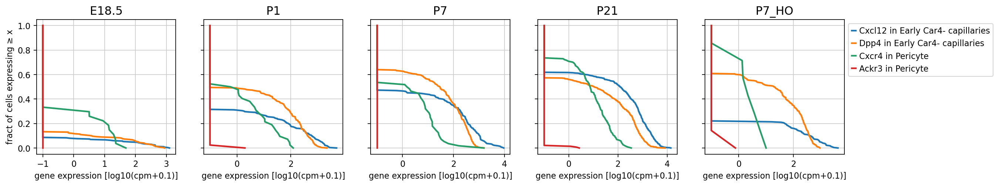

In [11]:
pairs_Car4=[
           ]
pairs_Early_Car4=[
               ['Cxcl12','Dpp4','Cxcr4','Ackr3']
                 ]
pairs_pericyte=[
               ]

pairs_cts=[['Car4+ capillaries','Pericyte'],['Early Car4- capillaries','Pericyte'],['Pericyte','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

for ct1,ct2 in pairs_cts:
    pairs=pairs_dic[ct1]
    for gene1,gene2,gene3,gene4 in pairs:
        fig,ax=plt.subplots(1,5,figsize=(15,3),sharey=True)
        for i in [0,1,2,3,4]:
            gene1_ct1=adata_dic[ct1][i][:,gene1].X.toarray()[:,0]
            gene1_ct1=np.log10(0.1+gene1_ct1)
            x=np.sort(gene1_ct1)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene1+ ' in ' +ct1,lw=2)
                
            gene2_ct1=(adata_dic[ct1])[i][:,gene2].X.toarray()[:,0]
            gene2_ct1=np.log10(0.1+gene2_ct1)
            x=np.sort(gene2_ct1)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene2+ ' in ' +ct1,lw=2)
            
            gene3_ct2=(adata_dic[ct2])[i][:,gene3].X.toarray()[:,0]
            gene3_ct2=np.log10(0.1+gene3_ct2)
            x=np.sort(gene3_ct2)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene3+ ' in ' +ct2,lw=2)
            
            gene4_ct2=(adata_dic[ct2])[i][:,gene4].X.toarray()[:,0]
            gene4_ct2=np.log10(0.1+gene4_ct2)
            x=np.sort(gene4_ct2)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene4+ ' in ' +ct2,lw=2)
            
            ax[i].set_xlabel('gene expression [log10(cpm+0.1)]',fontsize=10)
            ax[i].tick_params(labelsize=10)
            ax[0].set_ylabel('fract of cells expressing ≥ x',fontsize=10)
            ax[0].legend(loc='upper left',bbox_to_anchor=(5.8,1),bbox_transform=ax[0].transAxes,fontsize=10)
            
            if i==0:
                ax[i].set_title('E18.5')
            elif i==1:
                ax[i].set_title('P1')
            elif i==2:
                ax[i].set_title('P7')
            elif i==3:
                ax[i].set_title('P21')
            else:
                ax[i].set_title('P7_HO')
            
            #ax.grid(False)
            plt.tight_layout()
            plt.subplots_adjust(left=0.05)
            #fig.savefig('figures/interaction_endo_peri/cul/timepoint/'+gene1+' in '+ct1+' & '+gene2+' in '+ct2+'_cumul.png',bbox_inches = 'tight')

In [5]:
pairs_Car4=[
            ['Bmp2','Bmp2','Bmp2']
           ]
pairs_Early_Car4=[
                 ]
pairs_pericyte=[
               ]

pairs_cts=[['Car4+ capillaries','Early Car4- capillaries','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

for ct1,ct2,ct3 in pairs_cts:
    pairs=pairs_dic[ct1]
    for gene1,gene2,gene3 in pairs:
        fig,ax=plt.subplots(1,5,figsize=(15,3),sharey=True)
        for i in [0,1,2,3,4]:
            gene1_ct1=adata_dic[ct1][i][:,gene1].X.toarray()[:,0]
            gene1_ct1=np.log10(0.1+gene1_ct1)
            x=np.sort(gene1_ct1)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene1+ ' in ' +ct1,lw=2)
                
            gene2_ct2=(adata_dic[ct2])[i][:,gene2].X.toarray()[:,0]
            gene2_ct2=np.log10(0.1+gene2_ct2)
            x=np.sort(gene2_ct2)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene2+ ' in ' +ct2,lw=2)
            
            gene3_ct3=(adata_dic[ct3])[i][:,gene3].X.toarray()[:,0]
            gene3_ct3=np.log10(0.1+gene3_ct3)
            x=np.sort(gene3_ct3)
            y=1-np.linspace(0,1,len(x))
            ax[i].plot(x,y,label=gene3+ ' in ' +ct3,lw=2)
            
            ax[i].set_xlabel('gene expression [log10(cpm+0.1)]',fontsize=10)
            ax[i].tick_params(labelsize=10)
            ax[0].set_ylabel('fract of cells expressing ≥ x',fontsize=10)
            ax[0].legend(loc='upper left',bbox_to_anchor=(5.8,1),bbox_transform=ax[0].transAxes,fontsize=10)
            
            if i==0:
                ax[i].set_title('E18.5')
            elif i==1:
                ax[i].set_title('P1')
            elif i==2:
                ax[i].set_title('P7')
            elif i==3:
                ax[i].set_title('P21')
            else:
                ax[i].set_title('P7_HO')
            
            #ax.grid(False)
            plt.tight_layout()
            plt.subplots_adjust(left=0.05)
            #fig.savefig('figures/interaction_endo_peri/cul/timepoint/'+gene1+' in '+ct1+' & '+gene2+' in '+ct2+'_cumul.png',bbox_inches = 'tight')

NameError: name 'adata_d' is not defined

In [ ]:
sc.pp.log1p(adata)

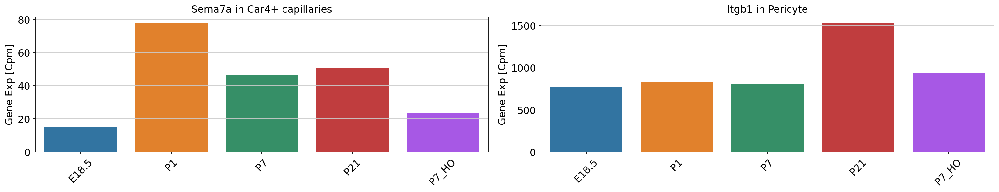

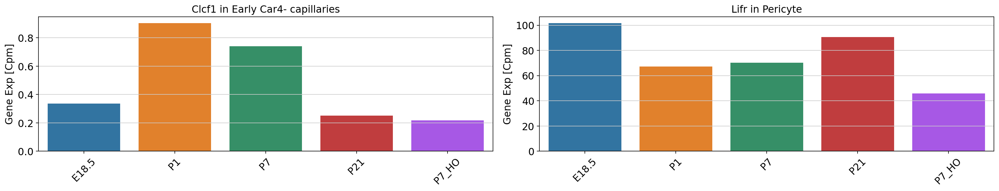

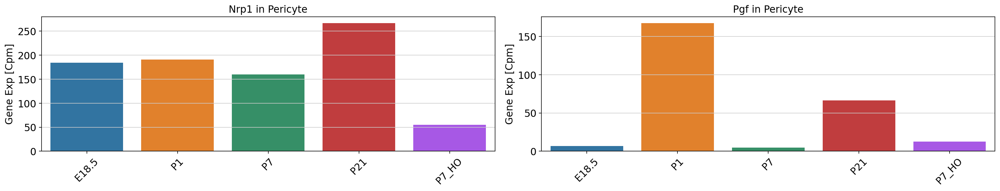

In [101]:
pairs_Car4=[
            ['Sema7a','Itgb1']
           ]
pairs_Early_Car4=[
            ['Clcf1','Lifr']
                 ]
pairs_pericyte=[
            ['Nrp1','Pgf']
               ]

pairs_cts=[['Car4+ capillaries','Pericyte'],['Early Car4- capillaries','Pericyte'],['Pericyte','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

#dataplot={}

for ct1,ct2 in pairs_cts:
    pairs=pairs_dic[ct1]
    y_gene1=[]
    y_gene2=[] 
    for gene1,gene2 in pairs:
        
        fig,axs=plt.subplots(1,2,figsize=(20,4))
        
        ax=axs[0]
        x=[0,1,2,3,4]
        y=[
            adata_dic[ct1][0][:,gene1].X.toarray()[:,0].mean(),
            adata_dic[ct1][1][:,gene1].X.toarray()[:,0].mean(),
            adata_dic[ct1][2][:,gene1].X.toarray()[:,0].mean(),
            adata_dic[ct1][3][:,gene1].X.toarray()[:,0].mean(),
            adata_dic[ct1][4][:,gene1].X.toarray()[:,0].mean()
        ]
        ax=sns.barplot(x,y,label=gene1+ ' in ' +ct1,lw=2,ax=ax)
        #std_gene1=gbi[ct1].std()[gene1]
        #sem_gene1=y.std()/np.sqrt(y.size()) 
        #ax.errorbar(x,y,yerr=std_gene1,color='green',ls='',capsize=5,label='std')
        #ax.errorbar(x,y,color='red',ls='',capsize=5,label='sem')
        ax.set_ylabel('Gene Exp [Cpm]')
        ax.set_title(gene1+' in '+ct1)
        ax.set_xticklabels(['E18.5','P1','P7','P21','P7_HO'],rotation=45)

        ax=axs[1]
        x=[0,1,2,3,4]
        y=[
            adata_dic[ct2][0][:,gene2].X.toarray()[:,0].mean(),
            adata_dic[ct2][1][:,gene2].X.toarray()[:,0].mean(),
            adata_dic[ct2][2][:,gene2].X.toarray()[:,0].mean(),
            adata_dic[ct2][3][:,gene2].X.toarray()[:,0].mean(),
            adata_dic[ct2][4][:,gene2].X.toarray()[:,0].mean()
        ]
        ax=sns.barplot(x,y,label=gene2+ ' in ' +ct2,lw=2,ax=ax)
        #std_gene2=gbi[ct2].std()[gene2]
        #sem_gene2=y.std()/np.sqrt(y.size())
        
        #ax.errorbar(x,y,yerr=std_gene2,color='green',ls='',capsize=5,label='std')
        #ax.errorbar(x,y,color='red',ls='',capsize=5,label='sem')
        ax.set_ylabel('Gene Exp [Cpm]')
        ax.set_title(gene2+' in '+ct2)
        ax.set_xticklabels(['E18.5','P1','P7','P21','P7_HO'],rotation=45)

        plt.tight_layout()
        plt.subplots_adjust(left=0.05)
        #fig.savefig('figures/interaction_endo_peri/cul/timepoint/'+gene1+' in '+ct1+' & '+gene2+' in '+ct2+'_cumul.png',bbox_inches = 'tight')

<ipython-input-102-040b28ca55b8>:61: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,axs=plt.subplots(1,2,figsize=(6,4),sharey=True)#sharey=True一横排共享一个y轴


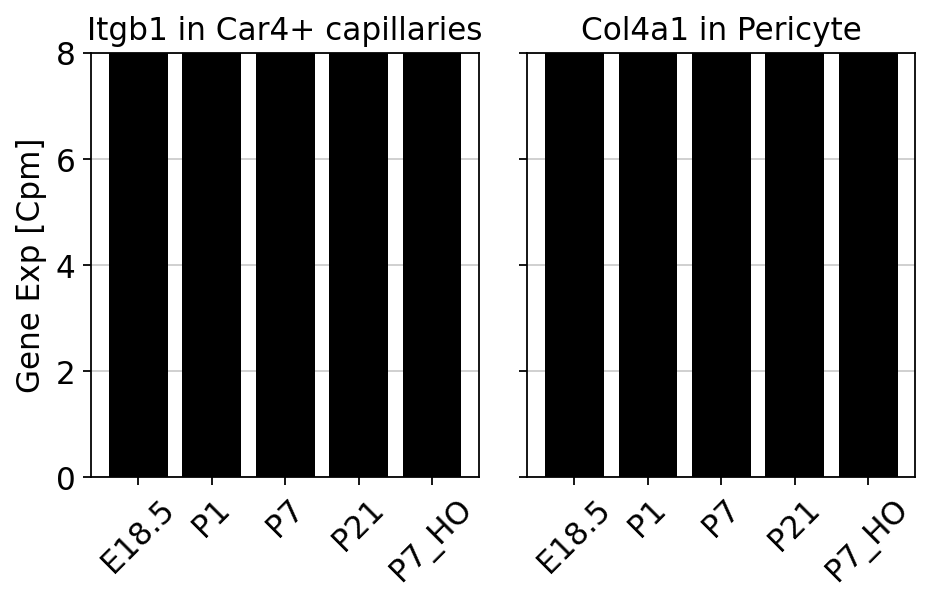

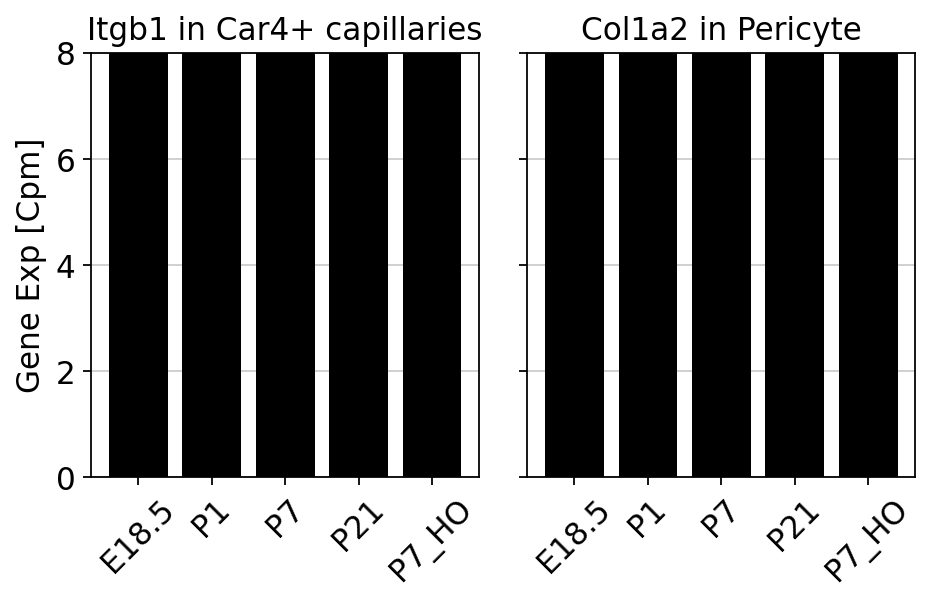

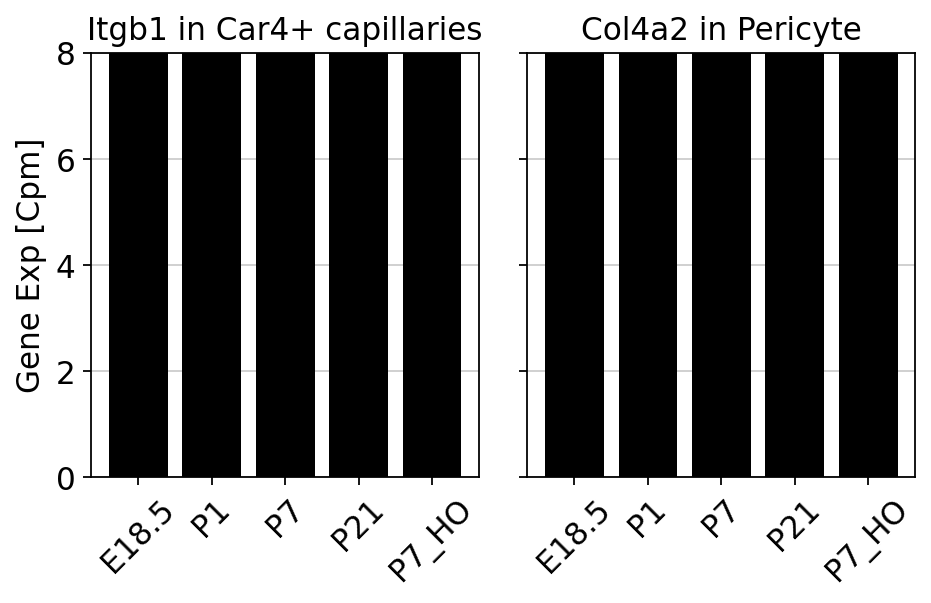

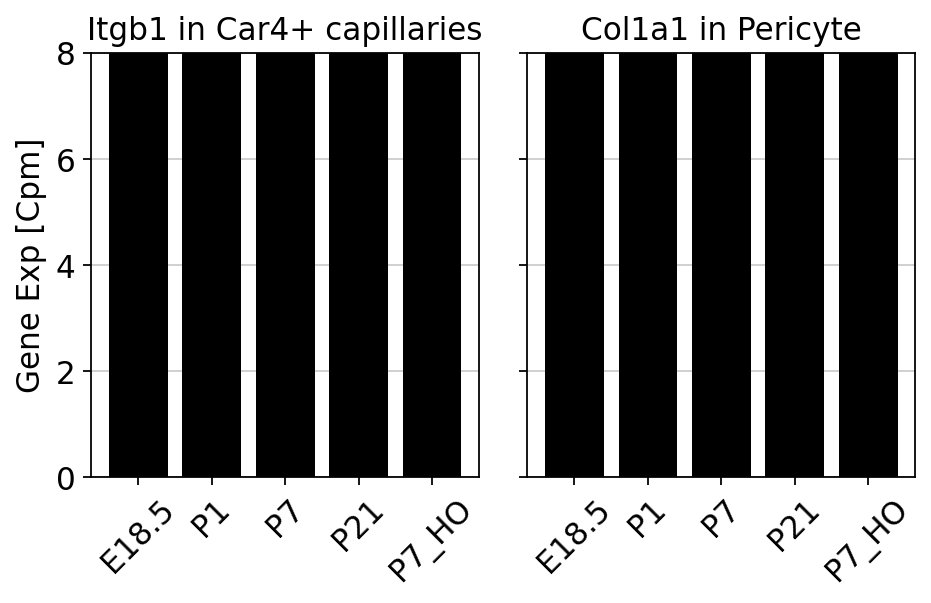

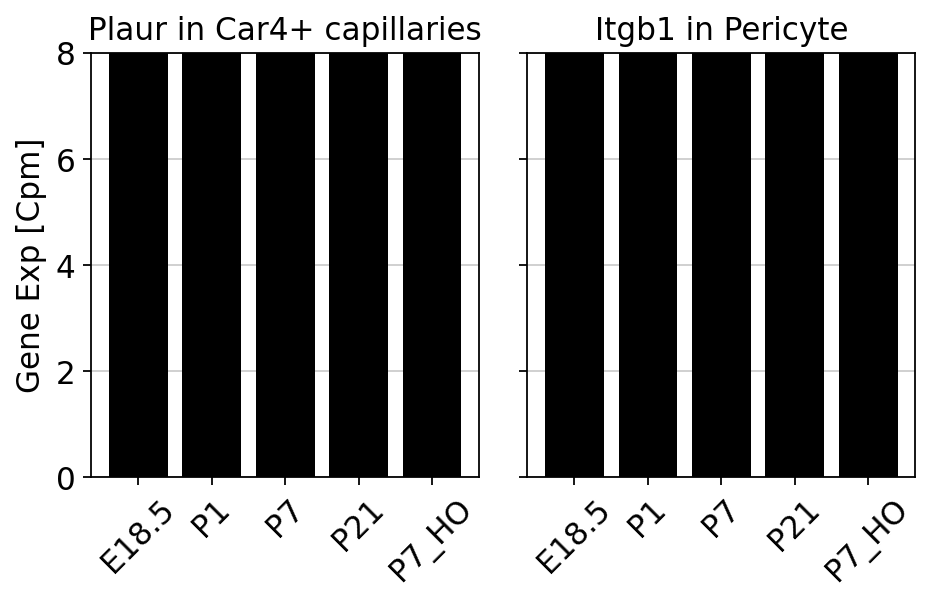

...

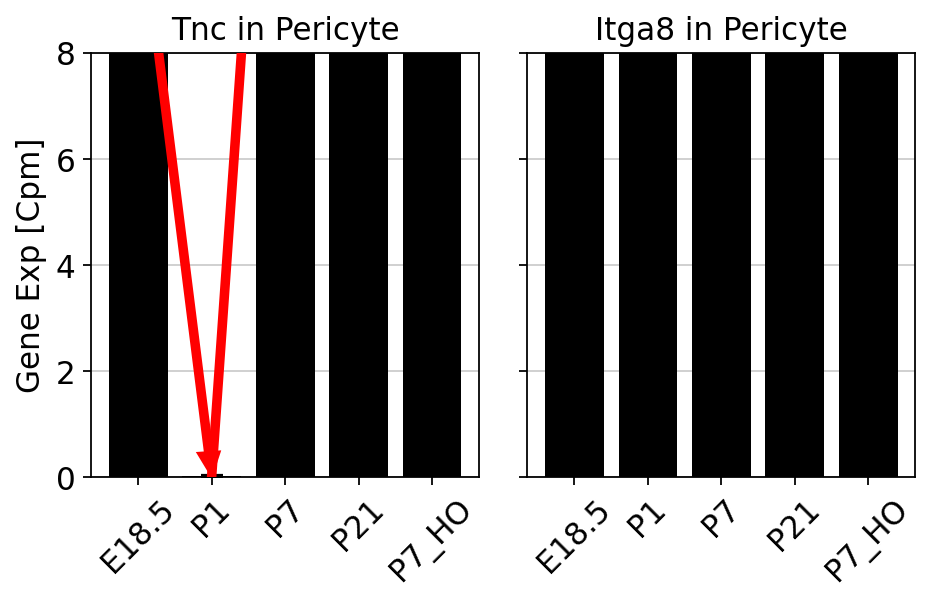

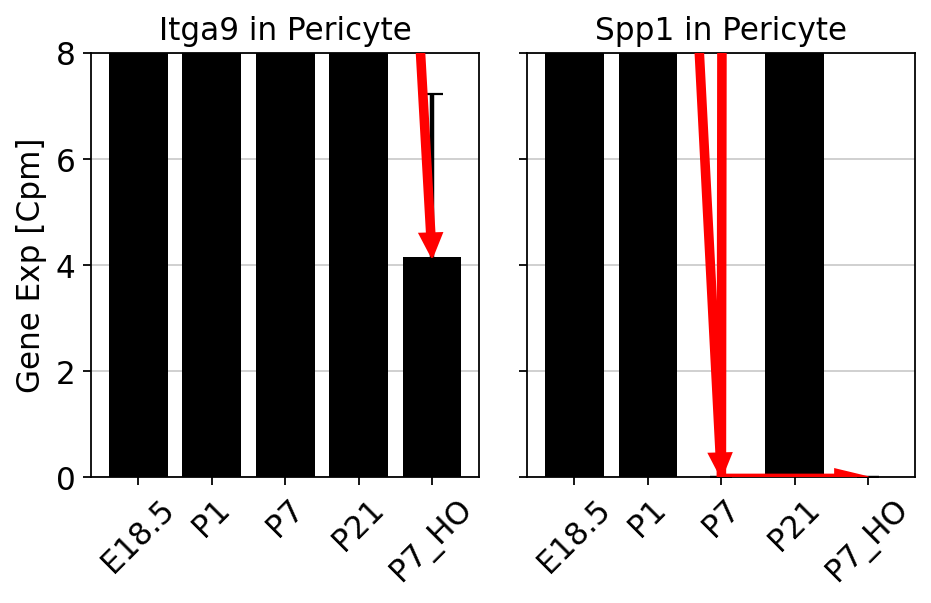

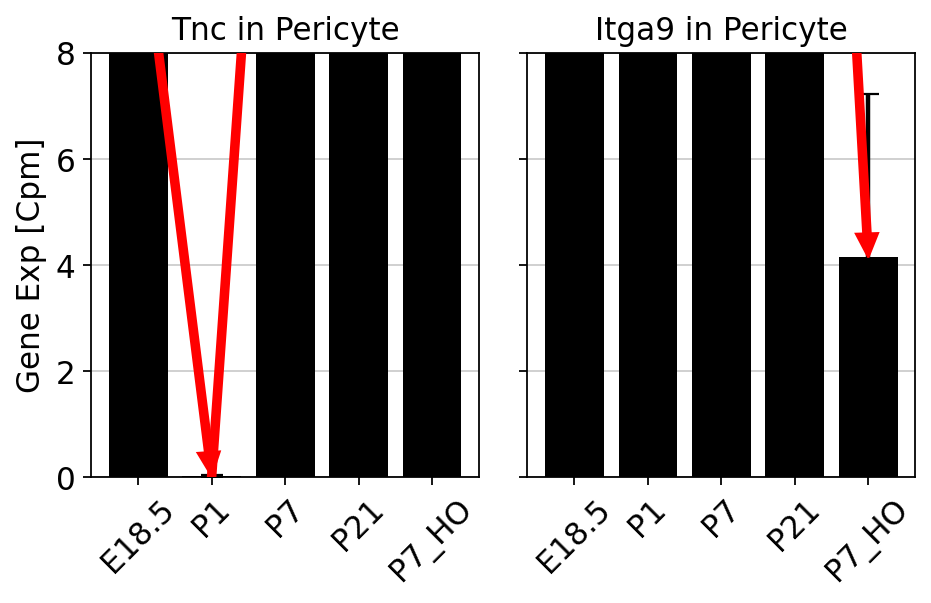

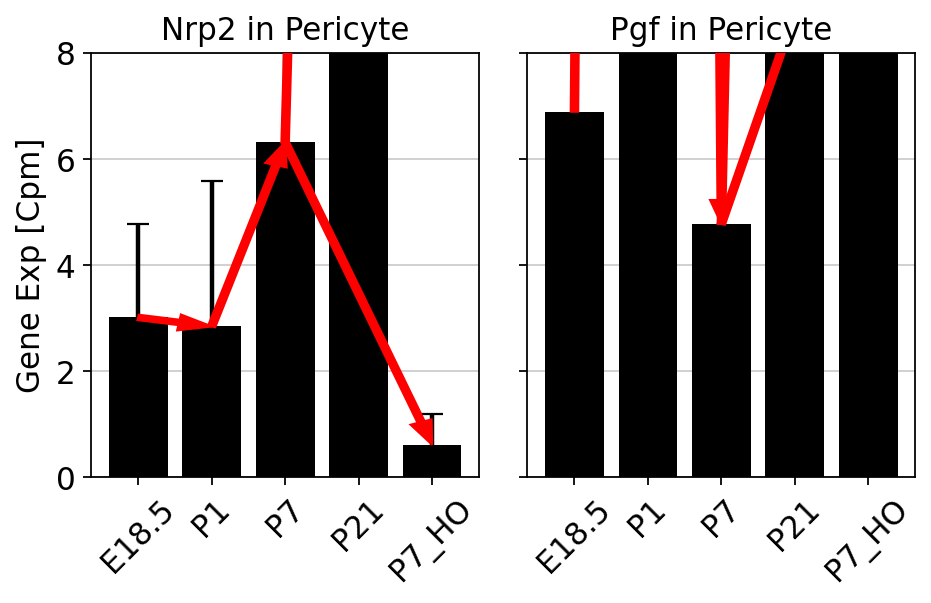

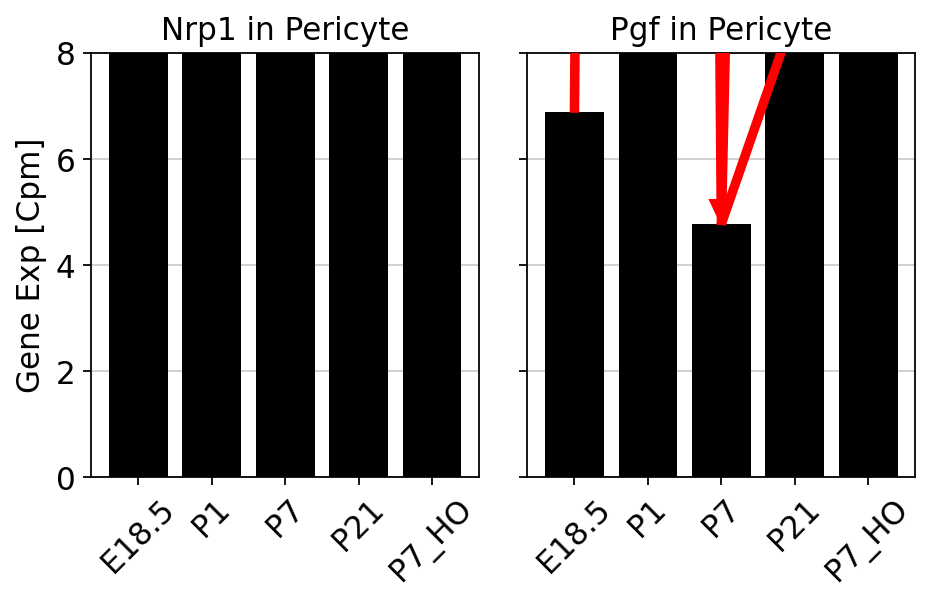

In [102]:
pairs_Car4=[['Itgb1','Col4a1'],['Itgb1','Col1a2'],['Itgb1','Col4a2'],['Itgb1','Col1a1'],
            ['Plaur','Itgb1'],['Plaur','Itga4'],['Plaur','Itgav'],
            ['Fbn1','Itgb1'],['Fbn1','Itga5'],
            ['Nectin3','Cadm1'],
            ['Itgb1','Lamc1'],
            ['Itgb1','Cspg4'],
            ['Pdgfb','Pdgfrb'],
            ['Sirpa','Cd47'],
            ['Sema7a','Itgb1']
           ]
pairs_Early_Car4=[['Col15a1','Itga1'],['Col15a1','Itgb1'],['Col18a1','Itga1'],['Col18a1','Itgb1'],
                  ['Dll1','Notch1'],['Dll1','Notch2'],['Dll1','Notch3'],['Dll1','Notch4'],
                  ['Cxcl12','Cxcr4'],
                  ['Bmp6','Bmpr2'],['Bmp6','Acvr2a'],['Bmp6','Bmpr1a'],['Bmp6','Acvr1'],['Bmp6','Acvr2b'],
                  ['Fzd6','Wnt5a'],['Fzd6','Wnt4'],['Fzd3','Wnt5a'],
                  ['Gas6','Axl'],['Il15ra','Axl'],['Il15ra','Il15'],
                  ['Clcf1','Il6st'],['Clcf1','Lifr']
                 ]
pairs_pericyte=[['Cadm1','Cadm1'],
                ['Cd44','Hbegf'],['Cd44','Hgf'],['Cd44','Spp1'],
                ['Wnt5a','Fzd1'],['Wnt4','Fzd1'],
                ['Bmpr1a','Bmp2'],['Bmpr1a','Bmp4'],['Bmpr1a','Bmp5'],
                ['Wnt5a','Ror1'],['Wnt4','Smo'],['Bmp2','Smo'],
                ['Fn1','Itga8'],['Tnc','Itga8'],
                ['Itga9','Spp1'],['Tnc','Itga9'],
                ['Nrp2','Pgf'],['Nrp1','Pgf']
               ]

pairs_cts=[['Car4+ capillaries','Pericyte'],['Early Car4- capillaries','Pericyte'],['Pericyte','Pericyte']]
pairs_dic={'Car4+ capillaries':pairs_Car4,'Early Car4- capillaries':pairs_Early_Car4,'Pericyte':pairs_pericyte}
adata_dic={
            'Pericyte':[
                    adata_d[('Pericyte','E18.5')],
                    adata_d[('Pericyte','P1')],
                    adata_d[('Pericyte','P7')],
                    adata_d[('Pericyte','P21')],
                    adata_d[('Pericyte','P7_HO')]
                        ],
           'Car4+ capillaries':[
                    adata_d[('Car4+ capillaries','E18.5')],
                    adata_d[('Car4+ capillaries','P1')],
                    adata_d[('Car4+ capillaries','P7')],
                    adata_d[('Car4+ capillaries','P21')],
                    adata_d[('Car4+ capillaries','P7_HO')]
                       ],
           'Early Car4- capillaries':[
                    adata_d[('Car4- capillaries','E18.5')],
                    adata_d[('Car4- capillaries','P1')],
                    adata_d[('Car4- capillaries','P7')],
                    adata_d[('Car4- capillaries','P21')],
                    adata_d[('Car4- capillaries','P7_HO')]
                       ]
          }

timepoint=['E18.5','P1','P7','P21','P7_HO']
y_gene_ct=[{},{}] #为了使用for循环产生y_gene1_ct1(y_gene_ct[0])和y_gene2_ct2(y_gene_ct[1])

for ct in pairs_cts: #ct is a list,ct[0]=ct1,ct[1]=ct2
    pairs=pairs_dic[ct[0]]
    for gene in pairs:
        fig,axs=plt.subplots(1,2,figsize=(6,4),sharey=True)#sharey=True一横排共享一个y轴
        for k,(gene_k,ct_k) in enumerate(zip(gene,ct)): #k代表的是数字，y_gene_ct[k]是dic，对应的key是（gene，ct）
            y_gene_ct[k][(gene_k,ct_k)]=[]
            x=[0,1,2,3,4]
            y=[]
            sem_gene_ct=[]
            x_arrow=[0,1,2,3,4]
            y_arrow=[] 
            #for loop添加元素之前先定义empty list
            for j,tp in enumerate(timepoint):
                gene_ct=adata_dic[ct_k][j][:,gene_k].X.toarray()[:,0]
                y_gene_ct[k][(gene_k,ct_k)].append(gene_ct)
                y.append(y_gene_ct[k][(gene_k,ct_k)][j].mean())
                sem_gene_ct.append((y_gene_ct[k][(gene_k,ct_k)][j]).std()/np.sqrt((y_gene_ct[k][(gene_k,ct_k)][j]).size))
                y_arrow.append(y_gene_ct[k][(gene_k,ct_k)][j].mean())
                
            ax=axs[k]
            ax=sns.barplot(x,y,label='_nolegend_',lw=2,ax=ax,color='black',zorder=10) 
            # label='_nolegend_'，legend没有这个图的；zorder把grid隐到后面
            ax.errorbar(x,y,yerr=sem_gene_ct,color='black',ls='',capsize=5,label='sem',lw=2)
            ax.set_title(gene_k+' in '+ct_k)
            ax.set_ylim(0,8)
            ax.set_xticklabels(['E18.5','P1','P7','P21','P7_HO'],rotation=45)
            for a in range(3): #E18.5-P1,P1-P7,P7-P21的箭头
                ax.arrow(x_arrow[a],y_arrow[a],x_arrow[a+1]-x_arrow[a],y_arrow[a+1]-y_arrow[a],length_includes_head=True,color='red',zorder=10,width=0.1)
            ax.arrow(x_arrow[2],y_arrow[2],x_arrow[4]-x_arrow[2],y_arrow[4]-y_arrow[2],length_includes_head=True,color='red',zorder=10,width=0.1) 
            # P7和P7_HO的箭头
            if k==0:
                ax.set_ylabel('Gene Exp [Cpm]') 
                #设置左图的label
        plt.tight_layout()
        plt.subplots_adjust(left=0.1)
        #fig.savefig('figures/interaction_endo_peri/timepoint/'+gene[0]+' in '+ct[0]+' & '+gene[1]+' in '+ct[1]+'_timepoint.png')

In [2]:
adata.obsm['X_umap']=adata.obs[['embed_endo_1','embed_endo_2']].values
adata_endo=adata[adata.obs['cellType']=='endothelial']
#sc.pl.umap(adata_endo,color='cellSubtype',palette=['#bd4f6f','#ee4242', '#3ab646','#a6bd4f','#4fbd9d', '#ffda4f', '#7d7d7d', '#664fbd','#1e1e1e','#4380c9'])

/usr/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):


In [3]:
sc.pp.log1p(adata_endo)
#sc.pl.umap(adata_endo,color='Spp1')

/usr/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:339: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


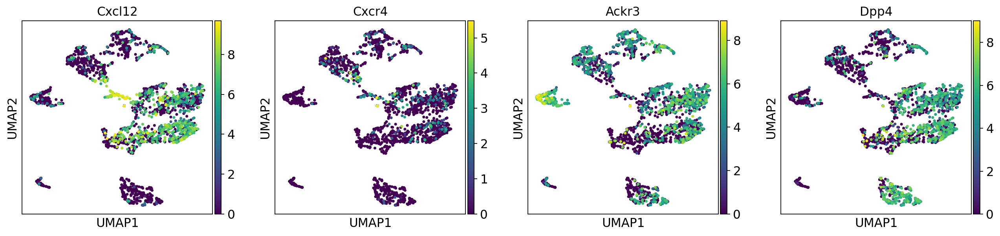

In [13]:
#sc.pl.umap(adata_endo,color=['Cxcl12','Cxcr4','Ackr3','Dpp4'],ncols=4)

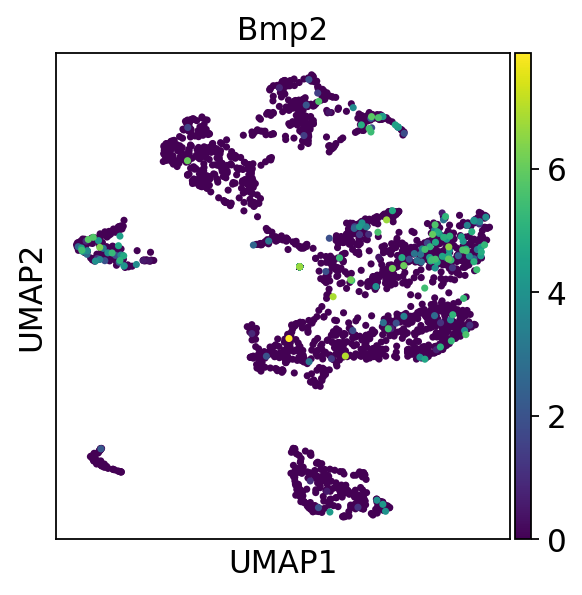

In [14]:
#sc.pl.umap(adata_endo,color='Bmp2')

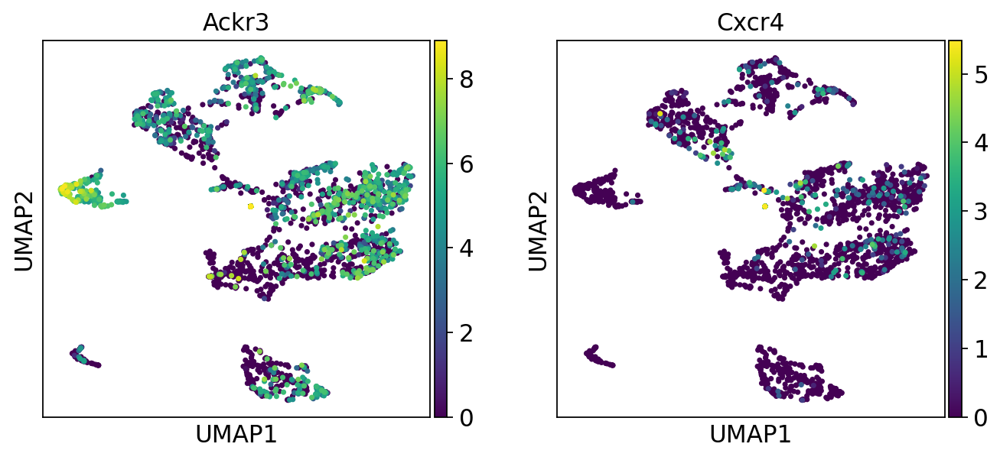

In [92]:
#sc.pl.umap(adata_endo,color=['Ackr3','Cxcr4'])

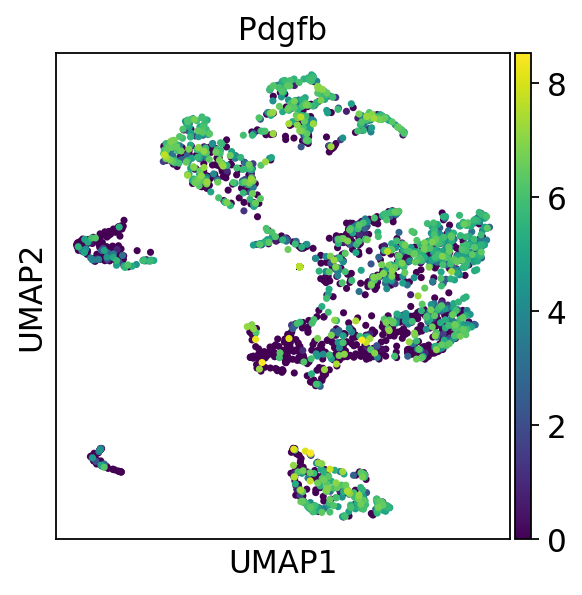

In [10]:
#sc.pl.umap(adata_endo,color='Pdgfb')

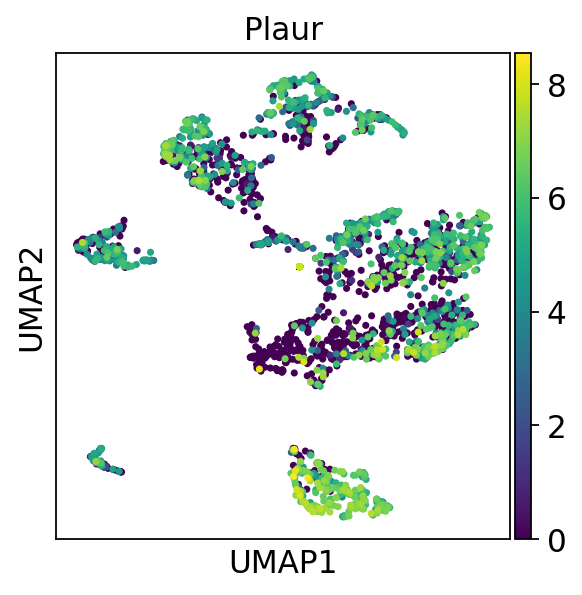

In [11]:
#sc.pl.umap(adata_endo,color='Plaur')

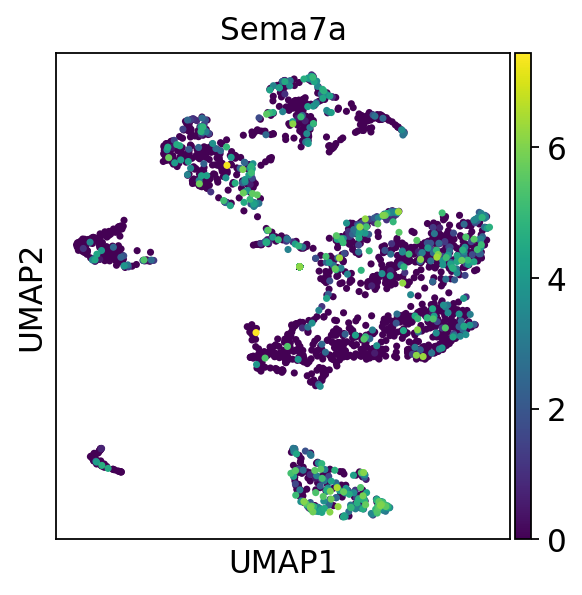

In [12]:
#sc.pl.umap(adata_endo,color='Sema7a')

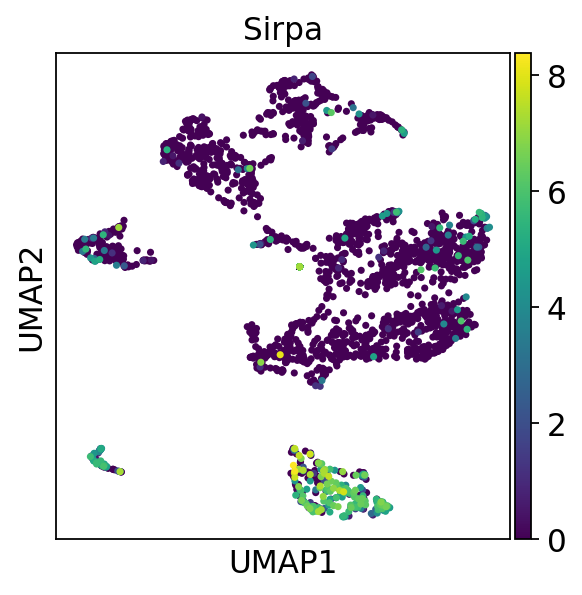

In [13]:
#sc.pl.umap(adata_endo,color='Sirpa')

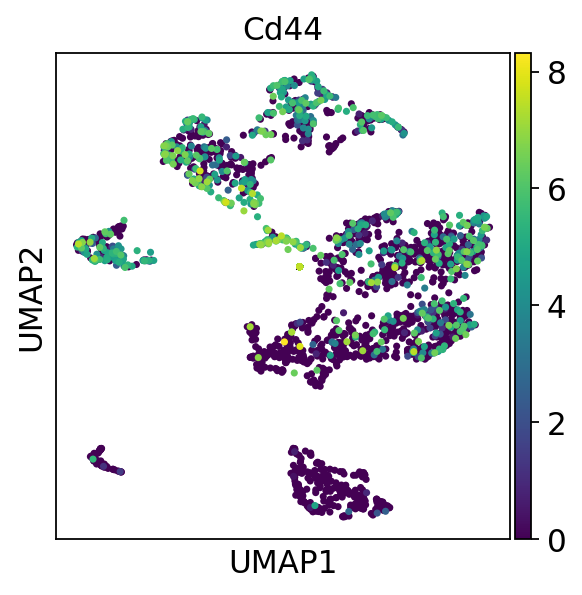

In [14]:
#sc.pl.umap(adata_endo,color='Cd44')

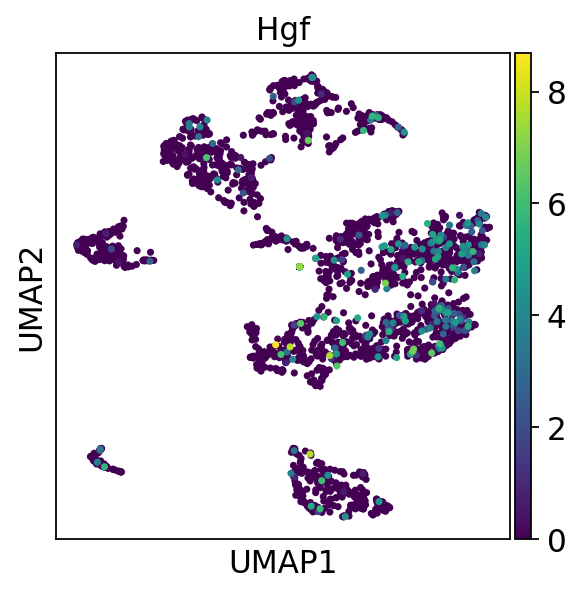

In [15]:
#sc.pl.umap(adata_endo,color='Hgf')